# Car simulation

In [1]:
import os
import dynamic_sound as ds
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import librosa
import IPython.display as ipd
import numpy as np
import pyroomacoustics as pra

In [ ]:
source_path = ds.Path([
    [0.0,  5,  150, 1,   1, 0, 0, 0],
    [20.0,  5, -150, 1,   1, 0, 0, 0]
])
reflection_path = ds.Path([
    [0.0,  5,  150, -1,   1, 0, 0, 0],
    [20.0,  5, -150, -1,   1, 0, 0, 0]
])
microphone_path = ds.Path([
    [0.0,  0, 0, 1,   1, 0, 0, 0],
    [20.0,  0, 0, 1,   1, 0, 0, 0]
])

# simulation environment
sim = ds.Simulation(
    temperature=20,
    pressure=1,
    relative_humidity=50
)

# microphone
mic_sample_rate = 8_192
microphone = ds.microphones.MicrophoneArray(file_path="_tmp/dynamicsound_car.wav", positions=[(0.02, 0.00, 0.00,  1, 0, 0, 0),
                                                                                                             (0.00, 0.02, 0.00,  1, 0, 0, 0),
                                                                                                             (-0.02, 0.00, 0.00,  1, 0, 0, 0),
                                                                                                             (0.00, -0.02, 0.00,  1, 0, 0, 0)], sample_rate=mic_sample_rate)
sim.add_microphone(path=microphone_path, microphone=microphone)

# source
source = ds.sources.AudioFile(filename="resources/sounds/suv_dirt_road.wav", gain_db=20)
sim.add_source(
    path=source_path,
    source=source
)

sim.add_source(
    path=reflection_path,
    source=source
)

sim.run()

343.2


100%|██████████| 163840/163840 [21:26<00:00, 127.35it/s]


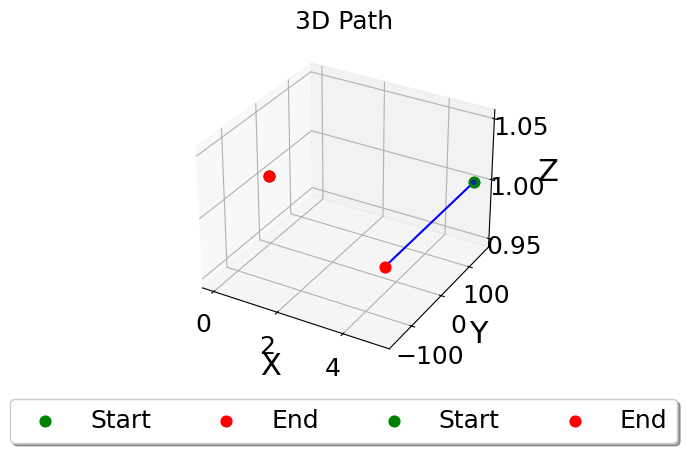

In [46]:
ax = source_path.plot_path_3d(show=False, legend=False)
microphone_path.plot_path_3d(ax=ax, show=False, legend=True)
#ax.set_aspect('equal')
plt.show()

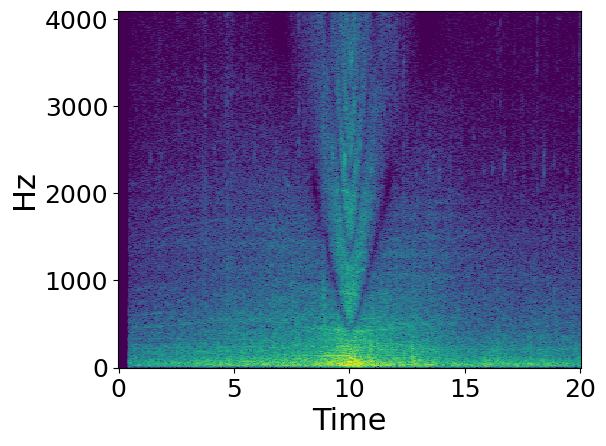

In [11]:
SMALL_SIZE = 18
MEDIUM_SIZE = 22
BIGGER_SIZE = 26

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title


signal, sr = librosa.load("_tmp/dynamicsound_car.wav", sr=None, mono=False)

if signal.ndim == 1:  # if single channel reshape to a common format (n_channels, n_samples)
    signal = signal.reshape(1, -1)
    
ipd.display(ipd.Audio(signal[0], rate=sr))

D = librosa.stft(signal[0])
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure()
librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='fft', cmap='viridis')
# plt.ylim(0, 4000)
# plt.colorbar(format='%+2.0f dB')
#plt.title('Spectrogram')
plt.tight_layout()
plt.savefig("_tmp/dynamicsound_car.png", dpi=300)
plt.show()


In [73]:
import pyroomacoustics as pra
import librosa
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from tqdm import tqdm

samples_out, sr = librosa.load("_tmp/dynamicsound_car.wav", sr=None, mono=False)
print(samples_out.shape)

c = 343.2  # speed of sound
nfft = 126 #256  # FFT size

resolution_step = 1  # degrees
algo = pra.doa.normmusic.NormMUSIC(L=microphone.get_microphones().T, c=c, fs=sr, nfft=nfft,
                                azimuth=np.deg2rad(np.arange(-180, 180, resolution_step)),
                                colatitude=np.deg2rad(np.arange(0, 180, resolution_step)),
                                dim=3, mode='near')
num_frames = 320
window_size = int(0.25*sr)
images = []
time = []
positions = []
true_positions = []
for start_sample in tqdm( range(0, len(samples_out[0])-window_size, len(samples_out[0]-window_size)//num_frames) ):

    X = np.array(
        [pra.transform.stft.analysis(signal, nfft, nfft // 2).T for signal in samples_out[:, start_sample:start_sample+window_size]]
    )
    algo.locate_sources(X, freq_range=[100, 1000])

    spatial_resp = algo.grid.values
    min_val = spatial_resp.min()
    max_val = spatial_resp.max()
    spatial_resp = (spatial_resp - min_val) / (max_val - min_val)
    images.append(spatial_resp.reshape((-1, 360//resolution_step)))
    
    time.append(start_sample / sr)
    positions.append((algo.azimuth_recon * 180 / np.pi, algo.colatitude_recon * 180 / np.pi))
    tpos, _ = source_path.get_position(start_sample / sr)
    true_positions.append((np.atan2(5, -tpos[1]) * 180 / np.pi, 90))


(4, 163840)


100%|██████████| 316/316 [04:01<00:00,  1.31it/s]


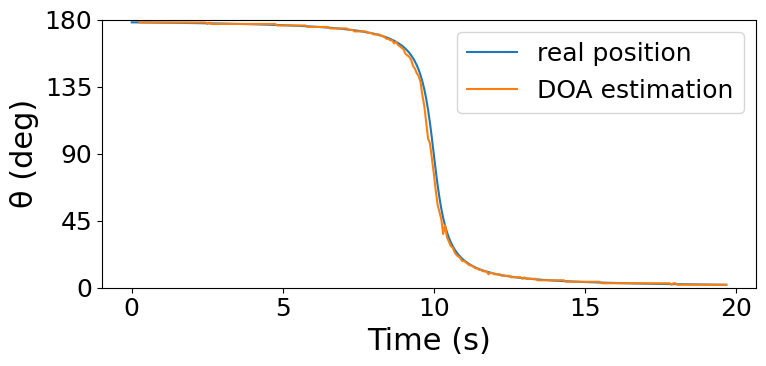

In [74]:
SMALL_SIZE = 18
MEDIUM_SIZE = 22
BIGGER_SIZE = 26

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

plt.figure(figsize=(8,4))
plt.plot(time, [x[0] for x in true_positions], label="real position")
plt.plot(time, [x[0][0]+90 for x in positions], label="DOA estimation")
plt.ylim(0, 180)
plt.xlabel('Time (s)')
plt.ylabel('θ (deg)')
plt.yticks(np.arange(0, 181, 45))
plt.legend()
plt.tight_layout()
plt.savefig("_tmp/car_position.png", dpi=300)
plt.show()

Animation size has reached 21048736 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


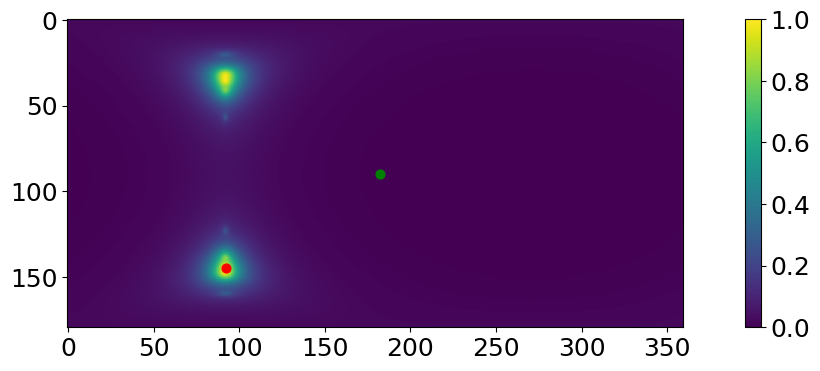

In [75]:

fig, ax = plt.subplots()
img = ax.imshow(images[0], animated=True, cmap='viridis')#, vmin=0.85)
im2 = ax.scatter(x=[0], y=[0], c='r', s=40, animated=True)
im3 = ax.scatter(x=[0], y=[0], c='g', s=40, animated=True)
fig.colorbar(img, ax=ax)
fig.set_size_inches(16, 4)
ax.set_aspect(1)

def update(frame):
    img.set_array(images[frame])
    im2.set_offsets([[180 + positions[frame][0][0], positions[frame][1][0]]])
    im3.set_offsets([[180 + true_positions[frame][0], true_positions[frame][1]]])
    return [img, im2, im3]

ani = FuncAnimation(fig, update, frames=len(images), interval=30000//num_frames, blit=True, repeat=True)
HTML(ani.to_jshtml())

